In [59]:
import tensorflow as tf
from matplotlib import pyplot as plt
import datetime
now = datetime.datetime.now

import importlib 

import data as ld
importlib.reload(ld)

import plots as lp
importlib.reload(lp)

import models as hc
importlib.reload(hc)



<module 'models' from '/Users/ldemuth/Documents/Tutorial_ML_SolidMechanics/Task3/Code/Solutions_task3/models.py'>

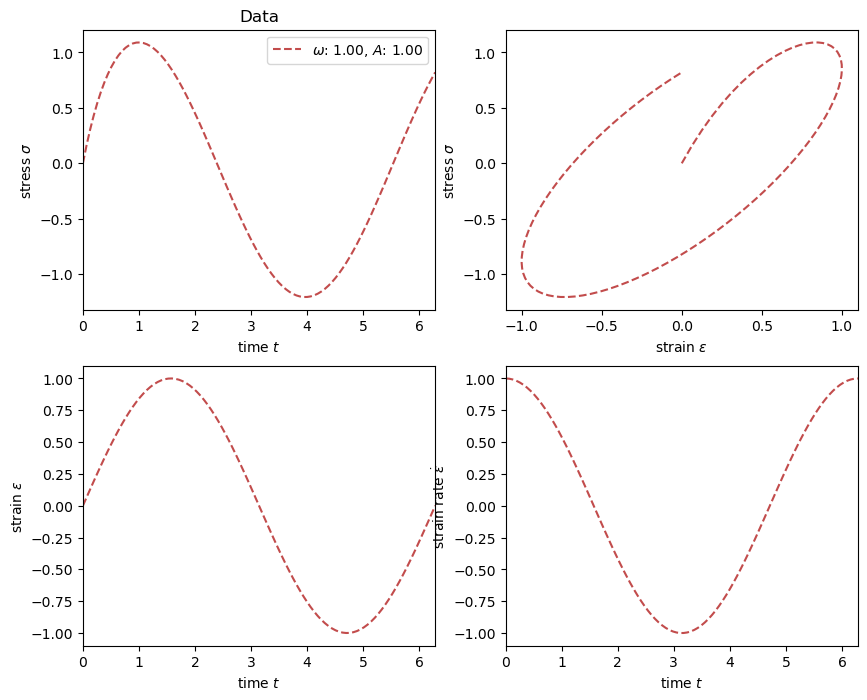

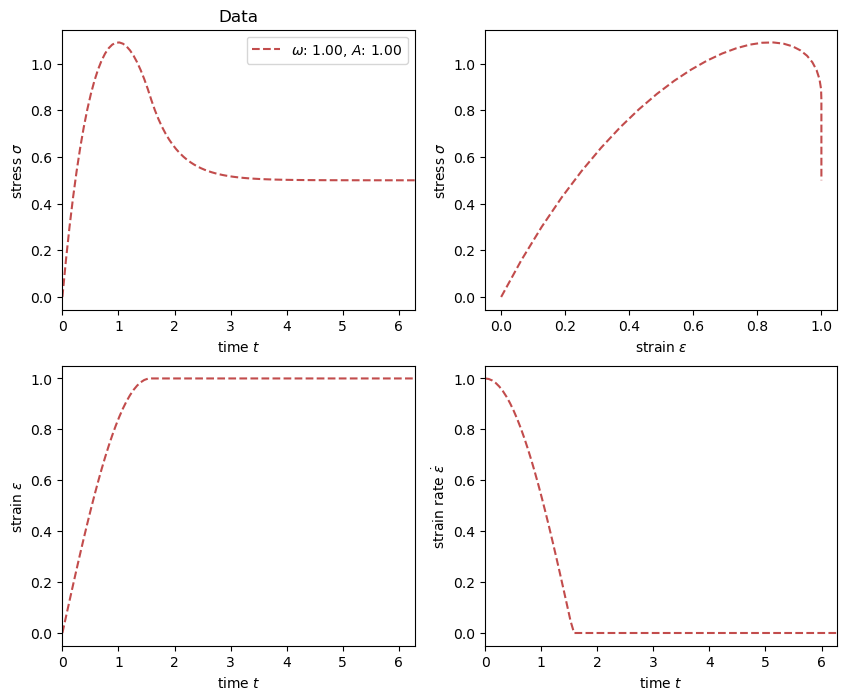

In [19]:
# Load and visualize data
E_infty = 0.5
E = 2
eta = 1

n = 100
omegas = [1]
As = [1]

eps, eps_dot, sig, dts = ld.generate_data_harmonic(E_infty, E, eta, n, omegas, As)
eps_rel, eps_dot_rel, sig_rel, dts_rel = ld.generate_data_relaxation(E_infty, E, eta, n, omegas, As)

lp.plot_data(eps, eps_dot, sig, omegas, As)
lp.plot_data(eps_rel, eps_dot_rel, sig_rel, omegas, As)

2025-01-25 14:52:36.970292
Epoch 1/10000


/Users/harchaoum/anaconda3/lib/python3.10/site-packages/keras/src/layers/layer.py:391: UserWarning: `build()` was called on layer 'rnn_cell', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(


1/1 - 2s - 2s/step - loss: 1.8250
Epoch 2/10000
1/1 - 0s - 59ms/step - loss: 1.7223
Epoch 3/10000
1/1 - 0s - 56ms/step - loss: 1.6260
Epoch 4/10000
1/1 - 0s - 54ms/step - loss: 1.5357
Epoch 5/10000
1/1 - 0s - 56ms/step - loss: 1.4513
Epoch 6/10000
1/1 - 0s - 56ms/step - loss: 1.3726
Epoch 7/10000
1/1 - 0s - 57ms/step - loss: 1.2993
Epoch 8/10000
1/1 - 0s - 54ms/step - loss: 1.2312
Epoch 9/10000
1/1 - 0s - 56ms/step - loss: 1.1679
Epoch 10/10000
1/1 - 0s - 55ms/step - loss: 1.1093
Epoch 11/10000
1/1 - 0s - 56ms/step - loss: 1.0551
Epoch 12/10000
1/1 - 0s - 54ms/step - loss: 1.0051
Epoch 13/10000
1/1 - 0s - 55ms/step - loss: 0.9590
Epoch 14/10000
1/1 - 0s - 56ms/step - loss: 0.9167
Epoch 15/10000
1/1 - 0s - 54ms/step - loss: 0.8778
Epoch 16/10000
1/1 - 0s - 57ms/step - loss: 0.8423
Epoch 17/10000
1/1 - 0s - 56ms/step - loss: 0.8098
Epoch 18/10000
1/1 - 0s - 58ms/step - loss: 0.7802
Epoch 19/10000
1/1 - 0s - 57ms/step - loss: 0.7533
Epoch 20/10000
1/1 - 0s - 57ms/step - loss: 0.7289
Epoch

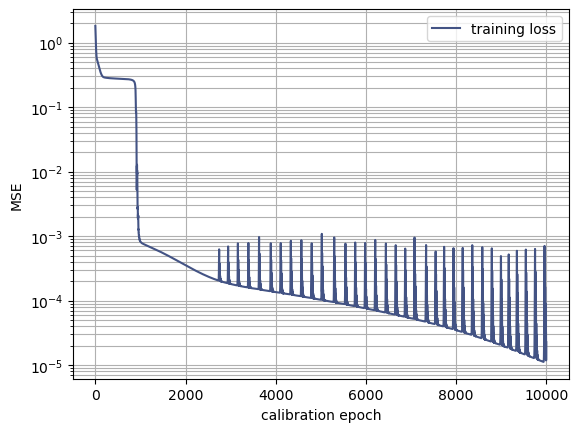

In [20]:
# Load and evaluate model
model = hc.main()

t1 = now()
print(t1)

model.optimizer.learning_rate.assign(0.002)

h = model.fit([eps, dts], [sig], epochs = 10000,  verbose = 2)

t2 = now()
print('it took', t2 - t1, '(sec) to calibrate the model')


plt.figure(1, dpi=100)
plt.semilogy(h.history['loss'], label='training loss', color=(67/255, 83/255, 132/255))
plt.grid(which='both')
plt.xlabel('calibration epoch')
plt.ylabel('MSE')
plt.legend()


### Is the model able to predict seen data - Reproduce data?

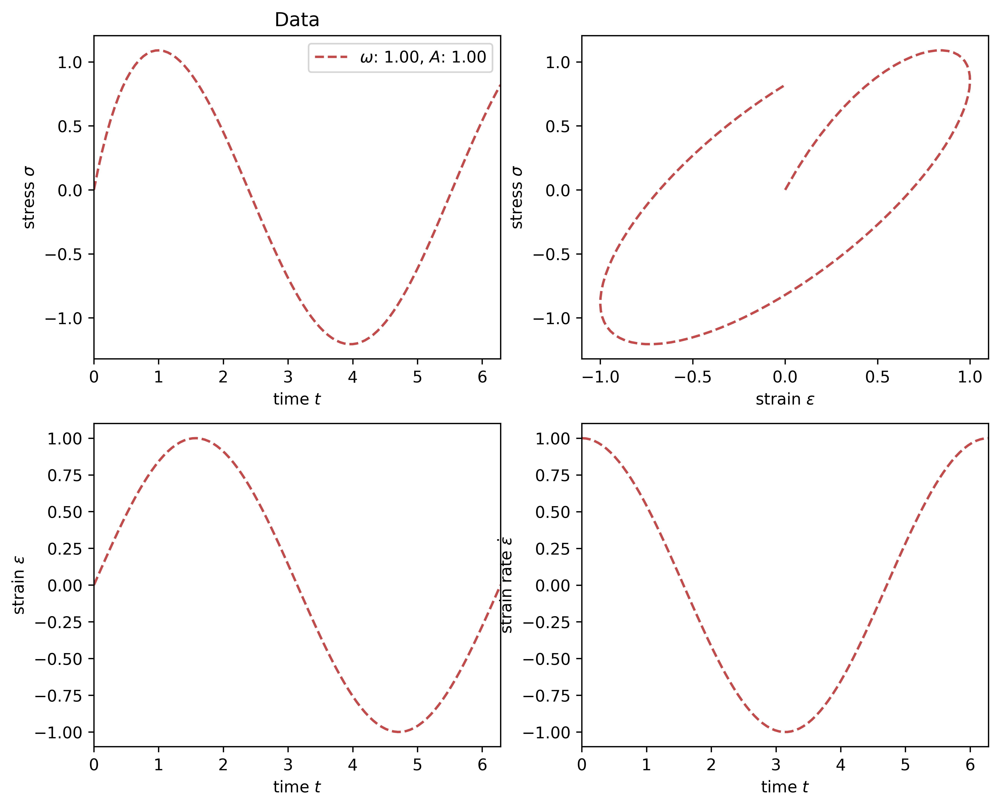

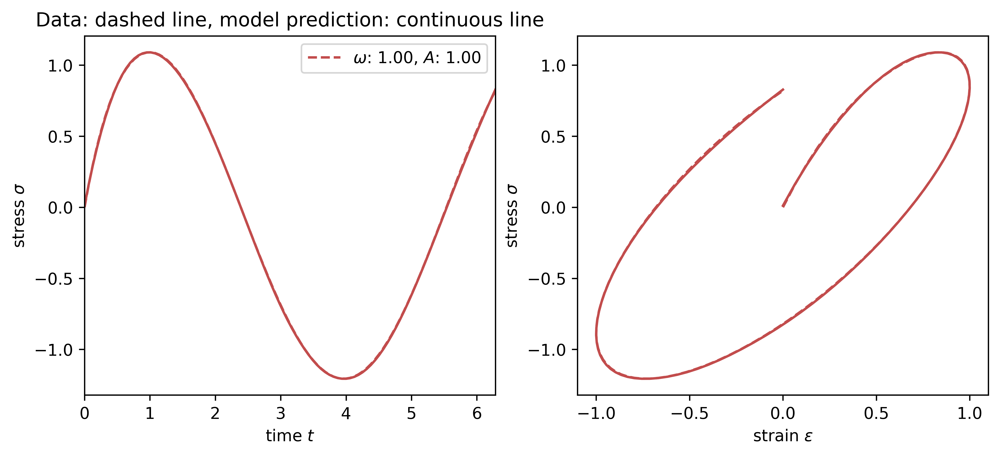

In [25]:
# Calibration data used for training 
E_infty = 0.5
E = 2
eta = 1

n = 100
omegas = [1]
As = [1]

eps, eps_dot, sig, dts = ld.generate_data_harmonic(E_infty, E, eta, n, omegas, As)
sig_m = model([eps, dts])
lp.plot_data(eps, eps_dot, sig, omegas, As)
lp.plot_model_pred(eps, sig, sig_m, omegas, As)

Yes, the model can reproduce data with which the model was trained!

## Is the model able to predict unseen data (extrapolation)?
- Here I only change the amplitude and the frequency 
The extrapolation behavior is not good, accuracy bad in particular after some time steps (euler discretization)

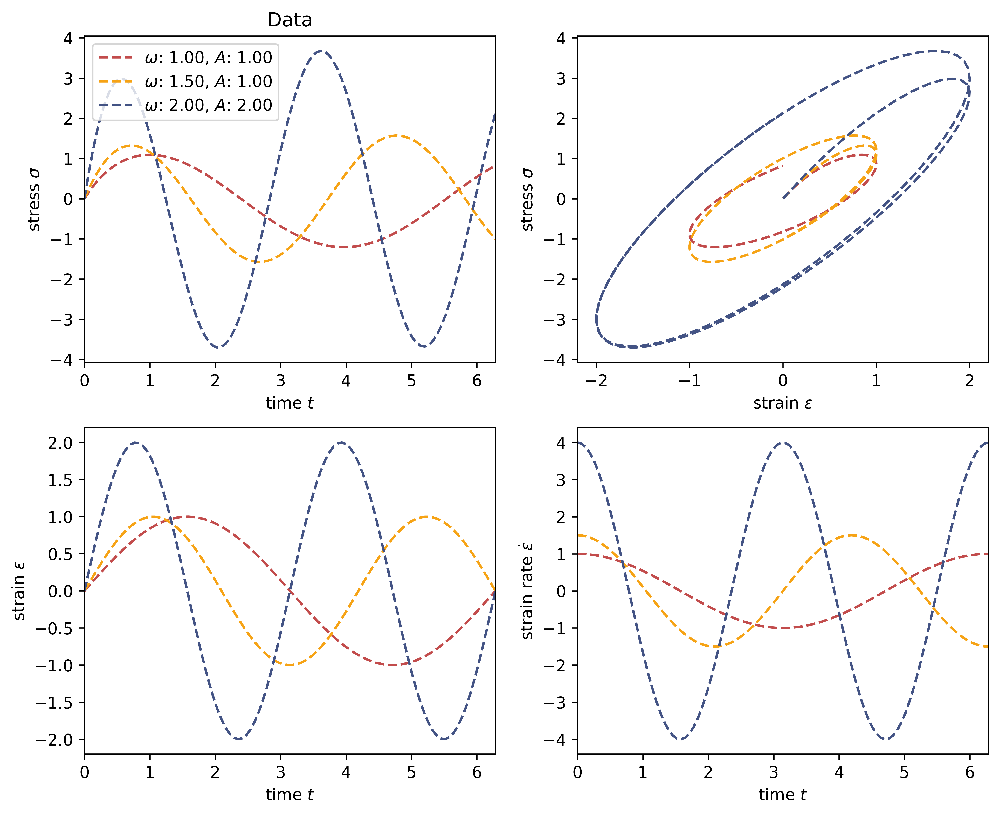

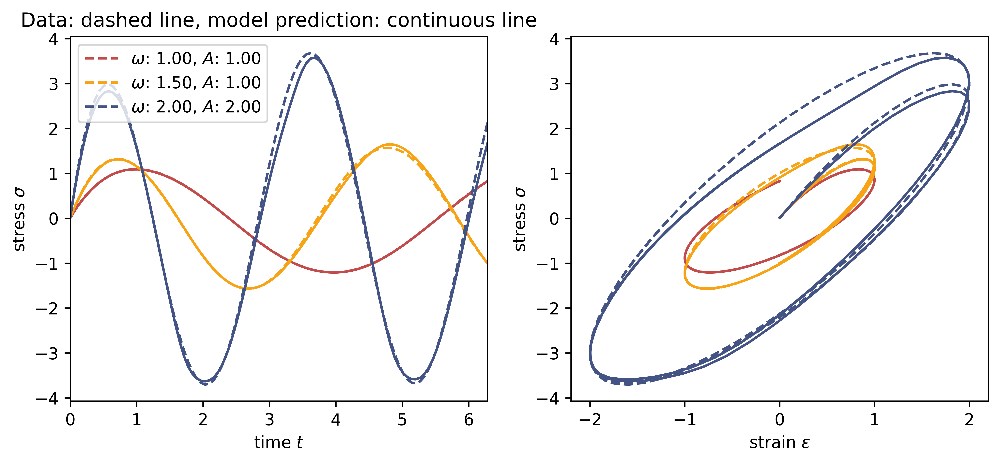

In [26]:
E_infty = 0.5
E = 2
eta = 1

n = 100

As = [1, 1, 2]
omegas = [1, 1.5, 2]

eps, eps_dot, sig, dts = ld.generate_data_harmonic(E_infty, E, eta, n, omegas, As)
sig_m = model([eps, dts])
lp.plot_data(eps, eps_dot, sig, omegas, As)
lp.plot_model_pred(eps, sig, sig_m, omegas, As)


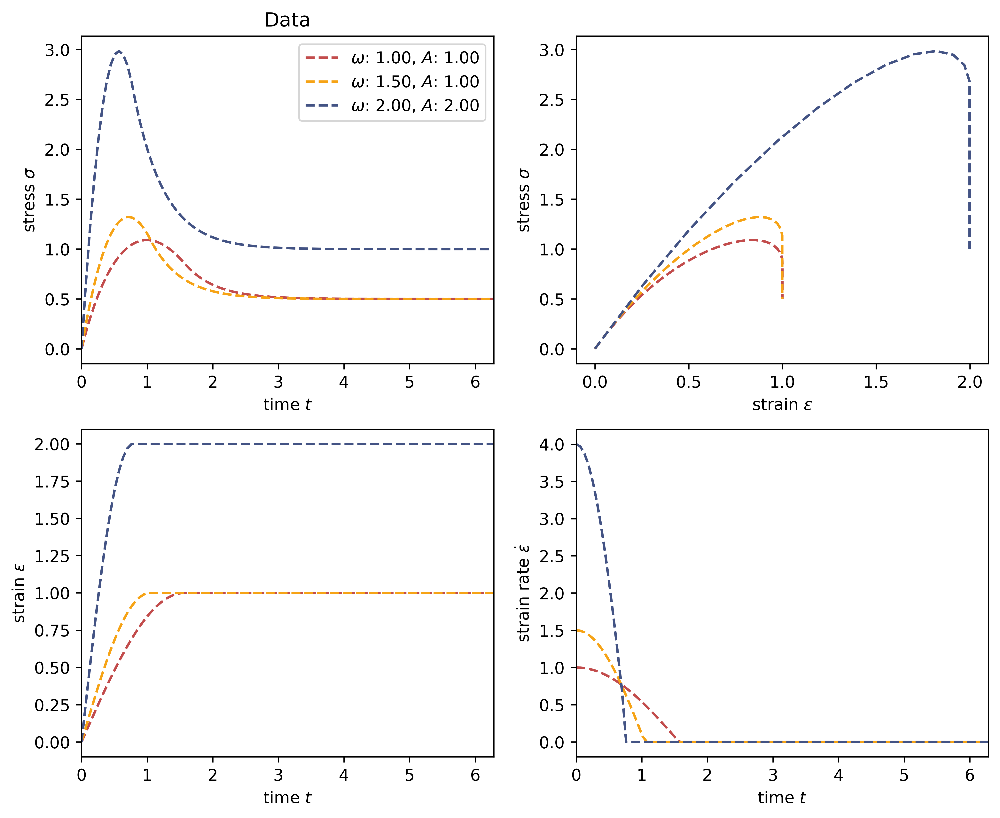

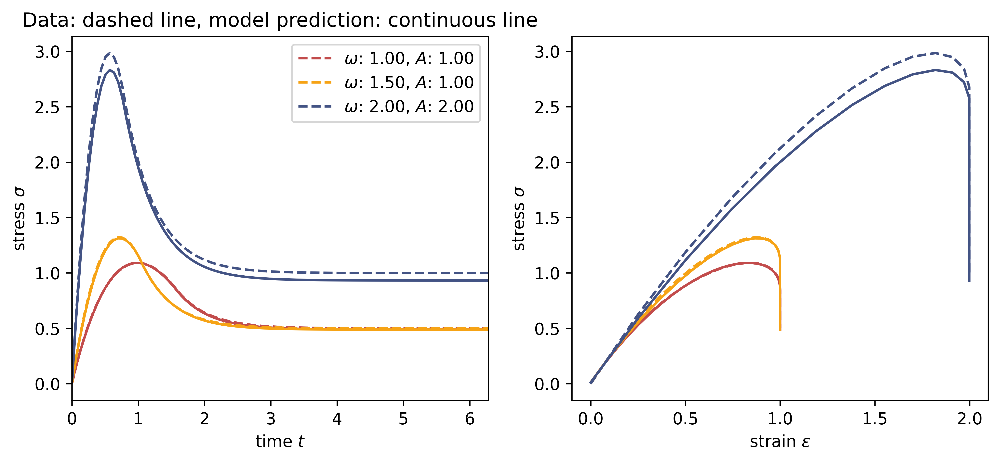

In [27]:
eps, eps_dot, sig, dts = ld.generate_data_relaxation(E_infty, E, eta, n, omegas, As)
sig_m = model([eps, dts])
lp.plot_data(eps, eps_dot, sig, omegas, As)
lp.plot_model_pred(eps, sig, sig_m, omegas, As)

## Which influence has the time step?
- I change the number of total time steps which directly influences the timestep dt:
    - increasing of n leads to smaller dt => smaller dt leads to an accumulation error. Why?
        - The model was trained for an time step size of dts = 0.06. If I increase n to n =1000, the dts = 0.006 is 10 times smaller. And in each time step my prediction is very bad because the model is not able to extrapolate. This error will accumalate
    - decrease of n leads ti larger dt => to small then the discretization is bad 


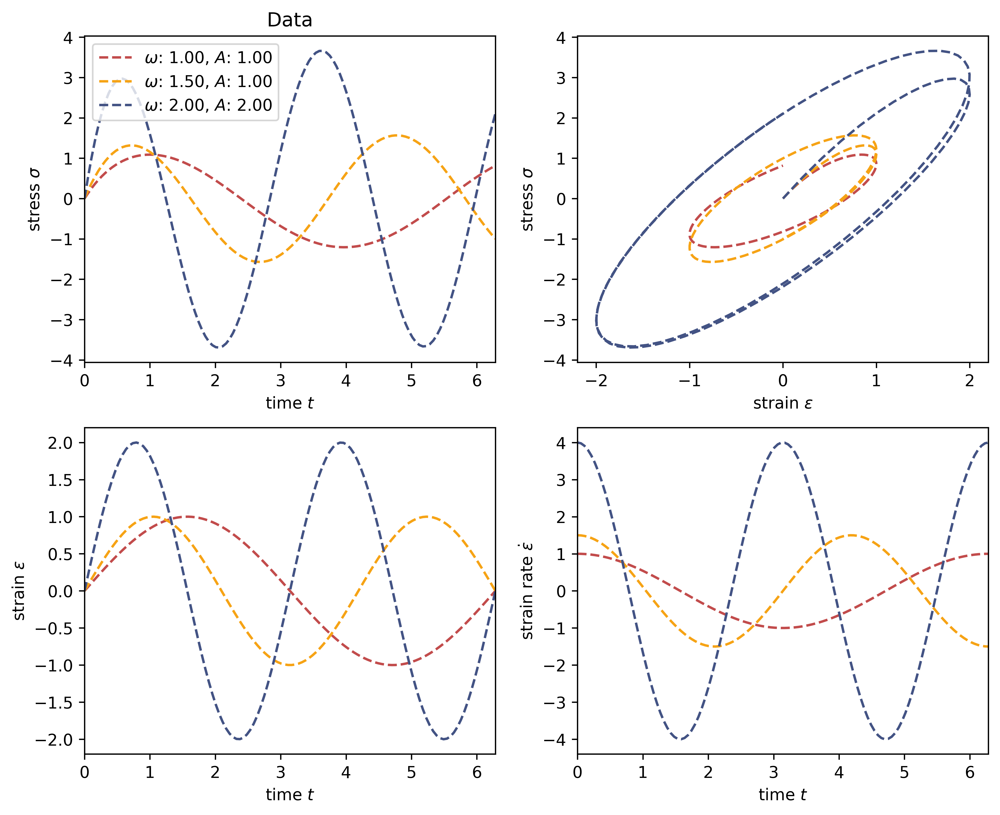

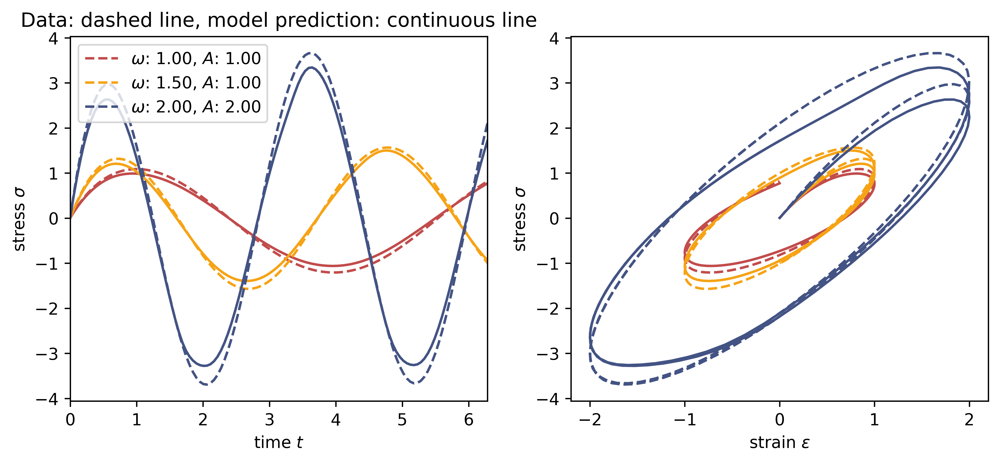

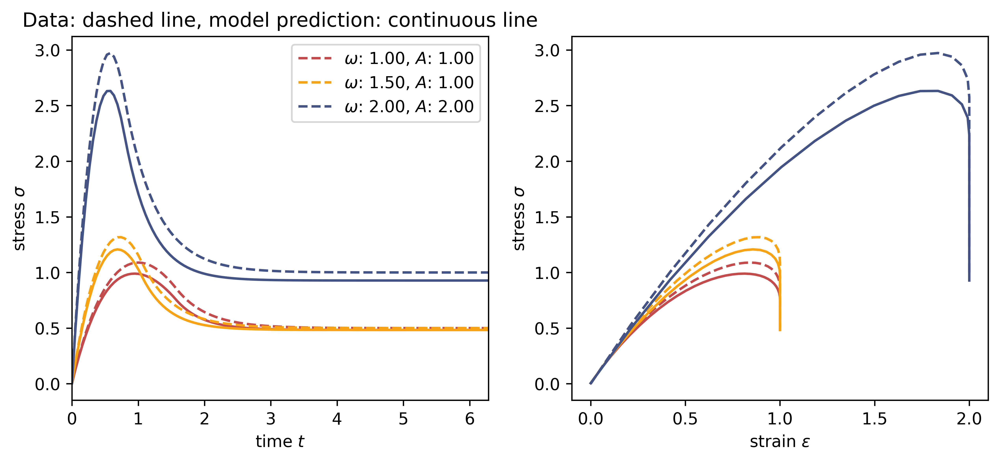

In [30]:
E_infty = 0.5
E = 2
eta = 1

n = 120

As = [1, 1, 2]
omegas = [1, 1.5, 2]

eps, eps_dot, sig, dts = ld.generate_data_harmonic(E_infty, E, eta, n, omegas, As)
eps_relax, eps_dot_relax, sig_relax, dts_relax = ld.generate_data_relaxation(E_infty, E, eta, n, omegas, As)
sig_m = model([eps, dts])
sig_m_relax = model([eps_relax, dts_relax])

lp.plot_data(eps, eps_dot, sig, omegas, As)
lp.plot_model_pred(eps, sig, sig_m, omegas, As)
lp.plot_model_pred(eps_relax, sig_relax, sig_m_relax, omegas, As)



## What will happen, if we change the maxwell model?
- Here I only change stiffness and viscosity 
THe extrapolation behavior is not good, accuracy bad in particular after some time steps (euler discretization)

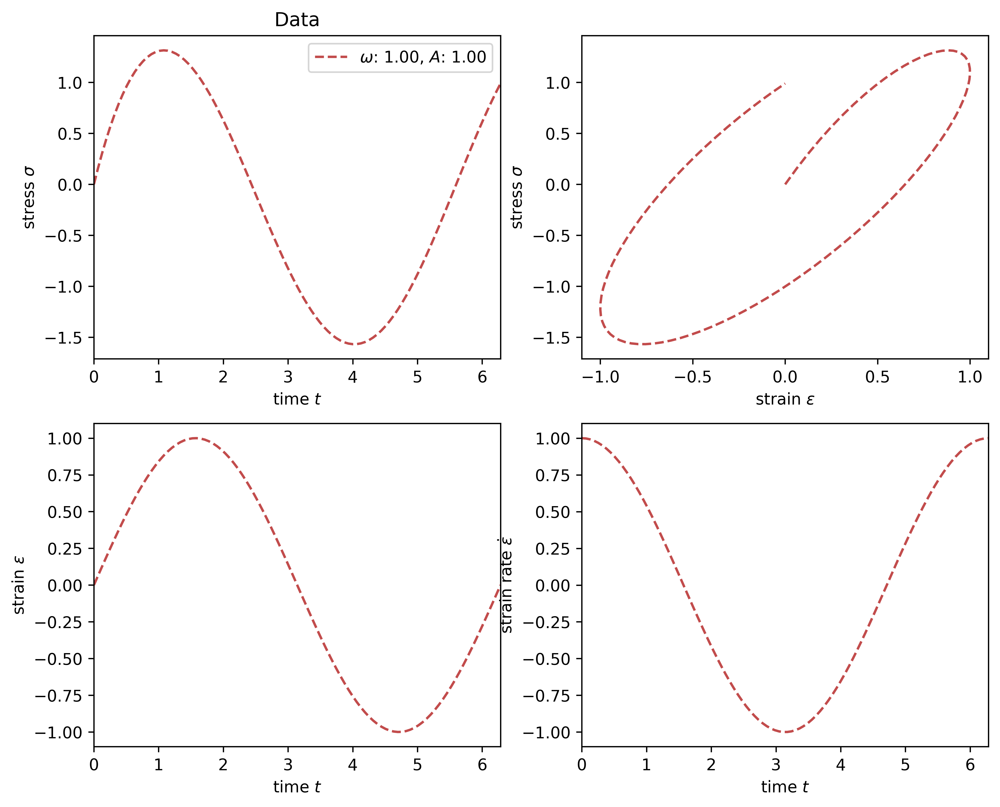

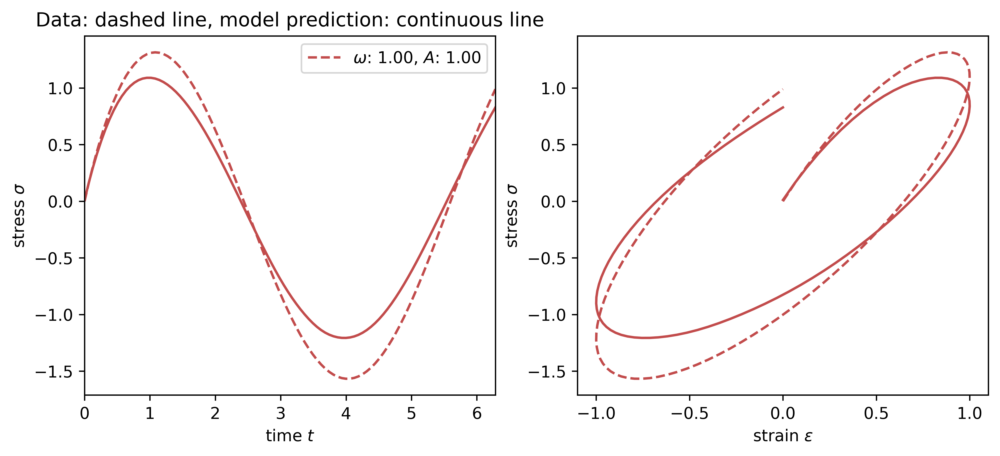

In [29]:
E_infty = 0.5
E = 2
eta = 1.5

n = 100

As = [1]
omegas = [1]

eps, eps_dot, sig, dts = ld.generate_data_harmonic(E_infty, E, eta, n, omegas, As)
sig_m = model([eps, dts])
lp.plot_data(eps, eps_dot, sig, omegas, As)
lp.plot_model_pred(eps, sig, sig_m, omegas, As)


# Task 2, part 1: Analytical Maxwell Modell

### The results of the analytical maxwell modell is exact to the training data. The training data was generated with the maxwell modell

In [31]:
E_inf = 0.5
E = 2
eta = 1

n = 100

As = [1, 1, 2]
omegas = [1, 1.5, 2]

eps, eps_dot, sig, dts = ld.generate_data_harmonic(E_inf, E, eta, n, omegas, As)


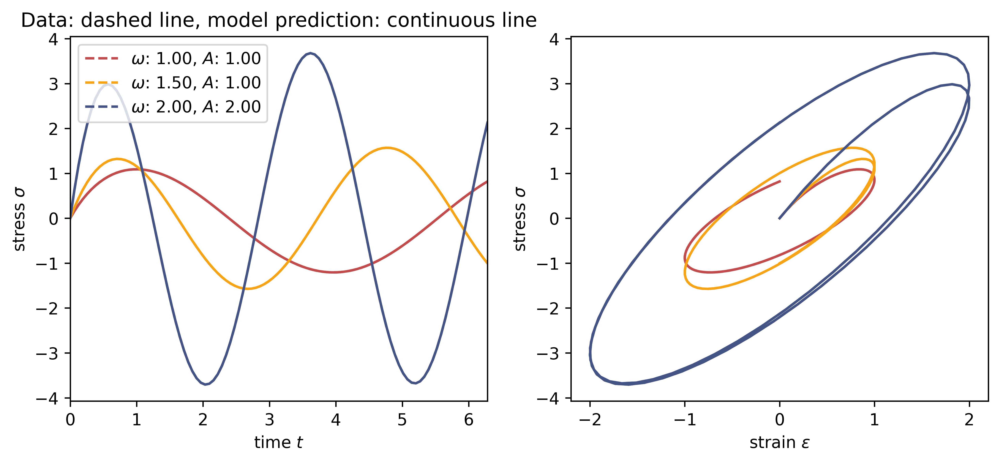

In [32]:
constants = {'E_inf': E_inf, 'E': E, 'eta': eta}      

MaxwellModellAnalytic = hc.main_MaxwellModel(constants)

sig_MaxwellAnalytic = MaxwellModellAnalytic([eps, dts])

lp.plot_model_pred(eps, sig, sig_MaxwellAnalytic, omegas, As)

# Task 2, part 2: Maxwell model with FFNN for general evolution equation

In [35]:
E_infity = 0.5
E = 2
eta = 1

constants = {'E_inf': 0.5, 'E': 2, 'eta': 1}  
n = 100
omegas = [1]
As = [1]

eps, eps_dot, sig, dts = ld.generate_data_harmonic(E_infity, E, eta, n, omegas, As)

In [ ]:

# Load and evaluate model
model_maxwellFFNN = hc.main_MaxwellModel_FFNN(constants)

t1 = now()
print(t1)

model_maxwellFFNN.optimizer.learning_rate.assign(0.002)

h = model_maxwellFFNN.fit([eps, dts], [sig], epochs = 10000,  verbose = 2)

t2 = now()
print('it took', t2 - t1, '(sec) to calibrate the model')


plt.figure(1, dpi=100)
plt.semilogy(h.history['loss'], label='training loss', color=(67/255, 83/255, 132/255))
plt.grid(which='both')
plt.xlabel('calibration epoch')
plt.ylabel('MSE')
plt.legend()


### Is the model able to predict seen data - Reproduce data?

In [ ]:
# Calibration data used for training 
E_infty = 0.5
E = 2
eta = 1

n = 100
omegas = [1]
As = [1]

eps, eps_dot, sig, dts = ld.generate_data_harmonic(E_infty, E, eta, n, omegas, As)
sig_maxwellFFNN = model_maxwellFFNN([eps, dts])
lp.plot_data(eps, eps_dot, sig, omegas, As)
lp.plot_model_pred(eps, sig, sig_maxwellFFNN, omegas, As)

## Is the model able to predict unseen data (extrapolation)?
- Here I only change the amplitude and the frequency 
=> THe extrapolation behavior is very good

In [ ]:
E_infty = 0.5
E = 2
eta = 1

n = 100

As = [1, 1, 2]
omegas = [1, 1.5, 2]

eps, eps_dot, sig, dts = ld.generate_data_harmonic(E_infty, E, eta, n, omegas, As)
sig_maxwellFFNN = model_maxwellFFNN([eps, dts])
lp.plot_data(eps, eps_dot, sig, omegas, As)
lp.plot_model_pred(eps, sig, sig_maxwellFFNN, omegas, As)

# Task 2 aber mit RKNN

In [62]:
E_inf = 0.5
E = 2
eta = 1

constants = {'E_inf': 0.5, 'E': 2, 'eta': 1}  
n = 100
omegas = [1]
As = [1]

eps, eps_dot, sig, dts = ld.generate_data_harmonic(E_inf, E, eta, n, omegas, As)

In [23]:
print("eps shape:", eps.shape)
print("dts shape:", dts.shape)
print("sig shape:", sig.shape)

eps shape: (1, 100, 1)
dts shape: (1, 100, 1)
sig shape: (1, 100, 1)


2025-01-25 18:30:39.031240
Epoch 1/10000


/Users/harchaoum/anaconda3/lib/python3.10/site-packages/keras/src/layers/layer.py:391: UserWarning: `build()` was called on layer 'maxwell_modell_ffnn_9', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(


1/1 - 2s - 2s/step - loss: 0.3256
Epoch 2/10000
1/1 - 0s - 70ms/step - loss: 0.3107
Epoch 3/10000
1/1 - 0s - 71ms/step - loss: 0.2962
Epoch 4/10000
1/1 - 0s - 67ms/step - loss: 0.2822
Epoch 5/10000
1/1 - 0s - 68ms/step - loss: 0.2686
Epoch 6/10000
1/1 - 0s - 152ms/step - loss: 0.2555
Epoch 7/10000
1/1 - 0s - 76ms/step - loss: 0.2429
Epoch 8/10000
1/1 - 0s - 78ms/step - loss: 0.2307
Epoch 9/10000
1/1 - 0s - 64ms/step - loss: 0.2191
Epoch 10/10000
1/1 - 0s - 67ms/step - loss: 0.2078
Epoch 11/10000
1/1 - 0s - 69ms/step - loss: 0.1971
Epoch 12/10000
1/1 - 0s - 71ms/step - loss: 0.1868
Epoch 13/10000
1/1 - 0s - 70ms/step - loss: 0.1769
Epoch 14/10000
1/1 - 0s - 67ms/step - loss: 0.1675
Epoch 15/10000
1/1 - 0s - 67ms/step - loss: 0.1585
Epoch 16/10000
1/1 - 0s - 74ms/step - loss: 0.1500
Epoch 17/10000
1/1 - 0s - 70ms/step - loss: 0.1418
Epoch 18/10000
1/1 - 0s - 76ms/step - loss: 0.1341
Epoch 19/10000
1/1 - 0s - 75ms/step - loss: 0.1267
Epoch 20/10000
1/1 - 0s - 71ms/step - loss: 0.1197
Epoc

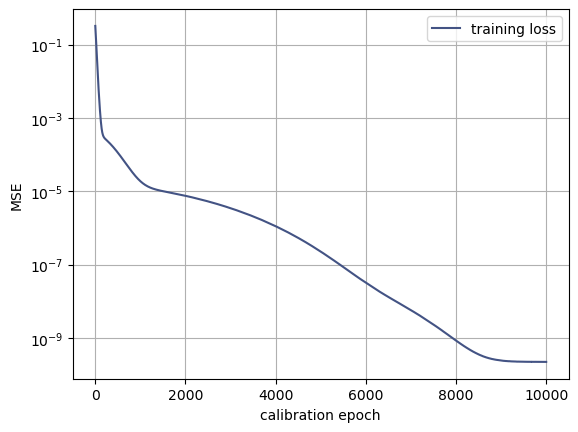

In [63]:
# Load and evaluate model
model_maxwellFFNN = hc.main_MaxwellModel_FFNN(constants)

t1 = now()
print(t1)

model_maxwellFFNN.optimizer.learning_rate.assign(0.002)

h = model_maxwellFFNN.fit([eps, dts], [sig], epochs = 10000,  verbose = 2)


t2 = now()
print('it took', t2 - t1, '(sec) to calibrate the model')


plt.figure(1, dpi=100)
plt.semilogy(h.history['loss'], label='training loss', color=(67/255, 83/255, 132/255))
plt.grid(which='both')
plt.xlabel('calibration epoch')
plt.ylabel('MSE')
plt.legend()

### Is the model able to predict seen data - Reproduce data?

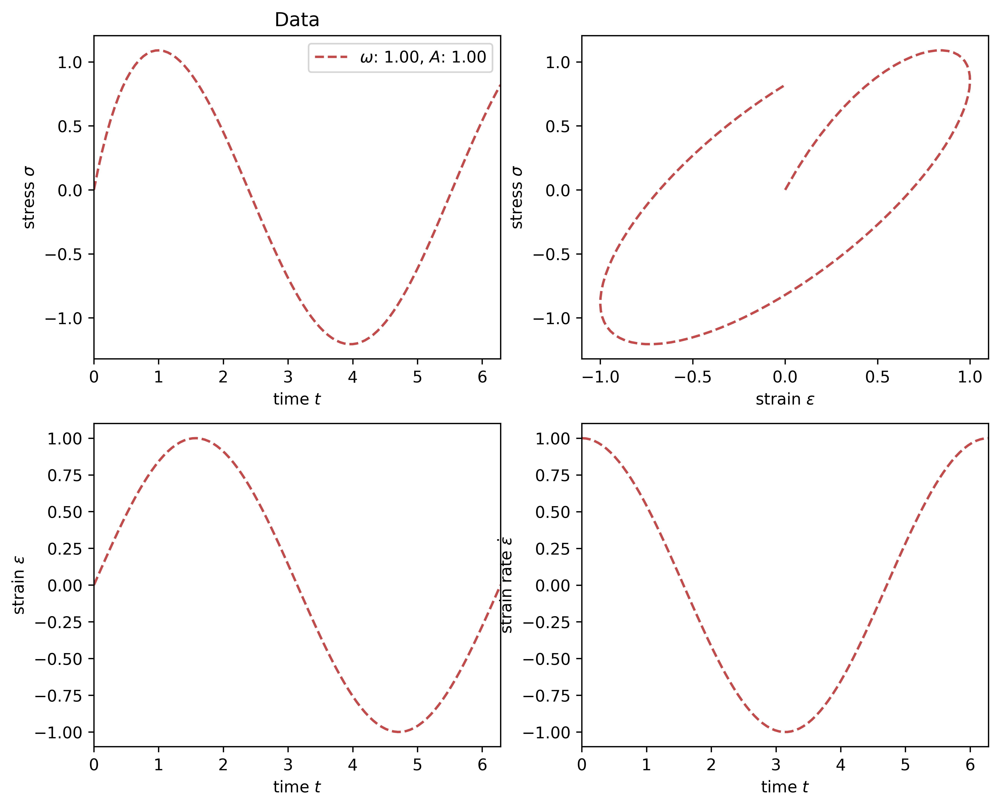

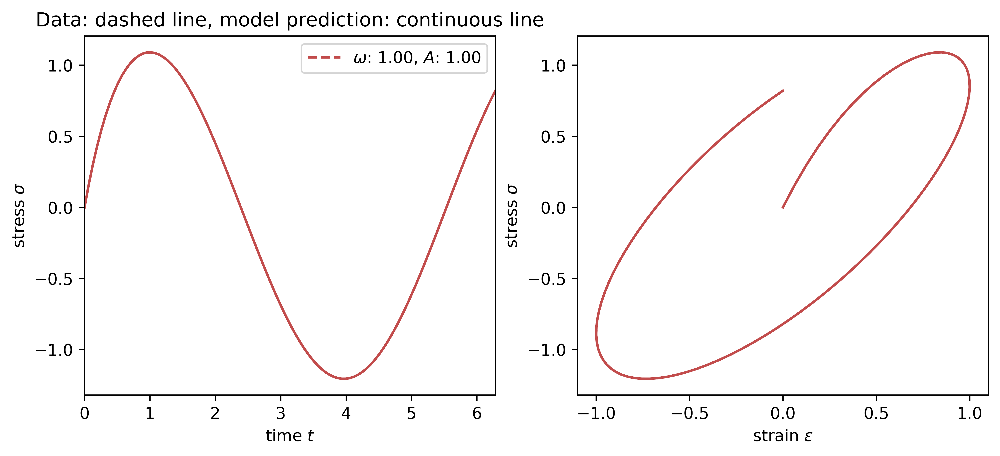

In [64]:
# Calibration data used for training 
E_inf = 0.5
E = 2
eta = 1

n = 100
omegas = [1]
As = [1]

eps, eps_dot, sig, dts = ld.generate_data_harmonic(E_inf, E, eta, n, omegas, As)
sig_maxwellFFNN = model_maxwellFFNN([eps, dts])
lp.plot_data(eps, eps_dot, sig, omegas, As)
lp.plot_model_pred(eps, sig, sig_maxwellFFNN, omegas, As)

## Is the model able to predict unseen data (extrapolation)?
- Here I only change the amplitude and the frequency 
=> The extrapolation behavior is very good

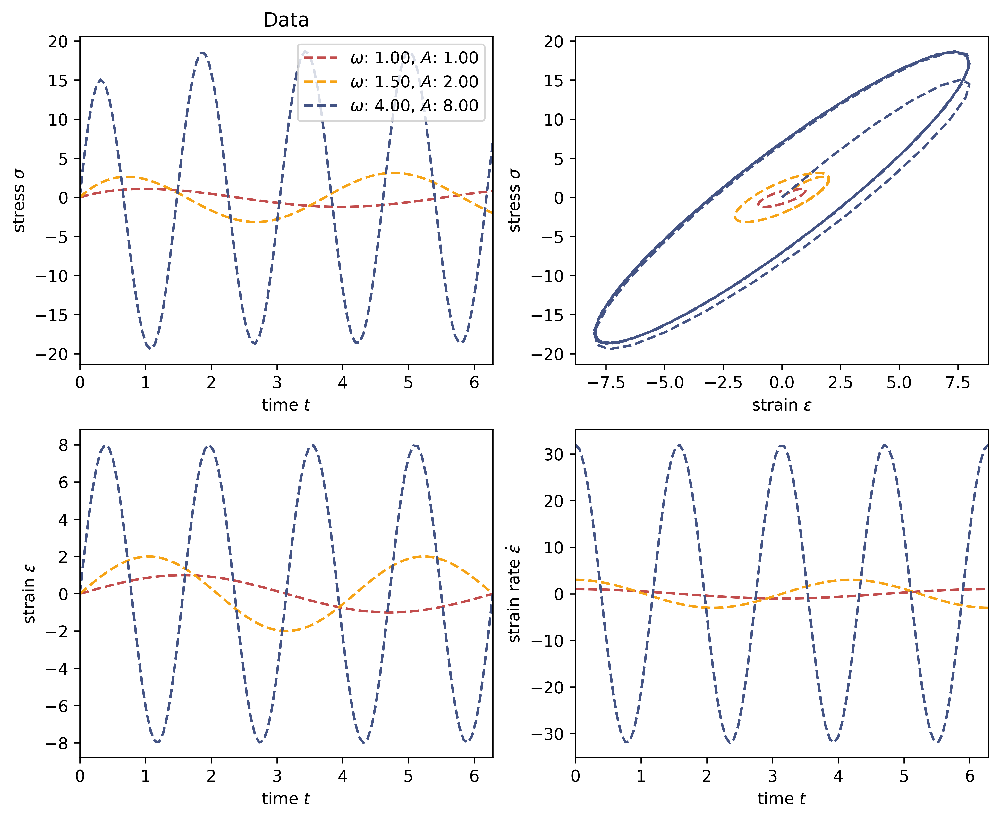

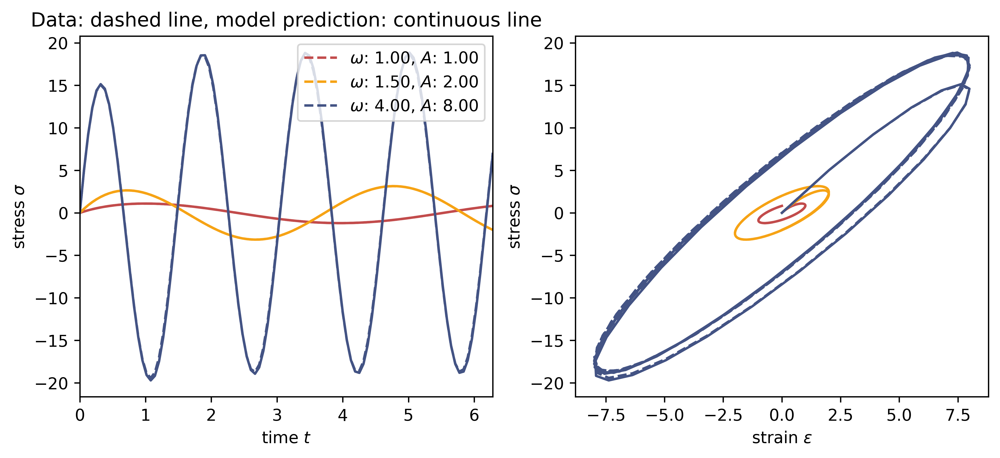

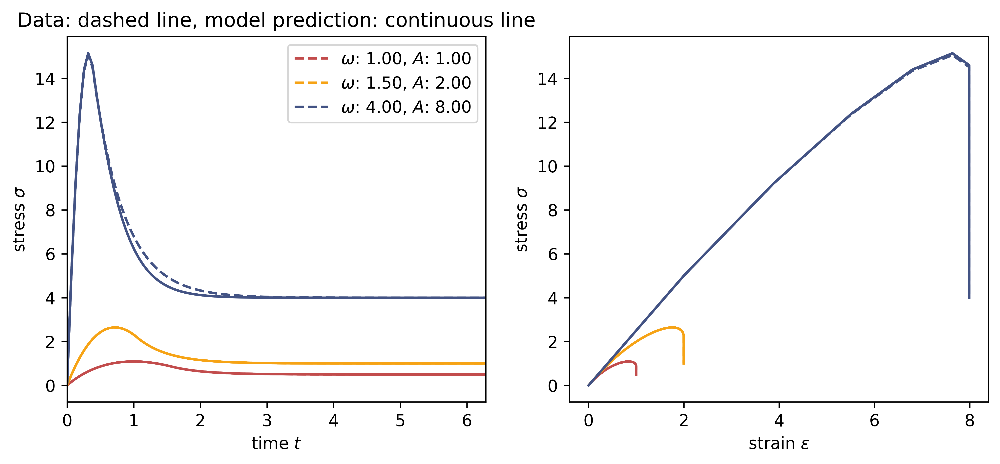

In [67]:
E_inf = 0.5
E = 2
eta = 1

n = 100

As = [1, 2, 8]
omegas = [1, 1.5, 4]

eps, eps_dot, sig, dts = ld.generate_data_harmonic(E_inf, E, eta, n, omegas, As)
eps_relax, eps_dot_relax, sig_relax, dts_relax = ld.generate_data_relaxation(E_infty, E, eta, n, omegas, As)
sig_maxwellFFNN = model_maxwellFFNN([eps, dts])
sig_maxwellFFNN_relax = model_maxwellFFNN([eps_relax, dts_relax])
lp.plot_data(eps, eps_dot, sig, omegas, As)
lp.plot_model_pred(eps, sig, sig_maxwellFFNN, omegas, As)
lp.plot_model_pred(eps_relax, sig_relax, sig_maxwellFFNN_relax, omegas, As)

# GSM Model
#### Trained for small amplitudes and frequencies

In [10]:
E_inf = 0.5
E = 2
eta = 1
n = 100
omegas = [1]
As = [1]


constant = {'eta': 1} 

eps, eps_dot, sig, dts = ld.generate_data_harmonic(E_inf, E, eta, n, omegas, As)

2025-01-25 17:14:50.483186
Epoch 1/10000


/Users/harchaoum/anaconda3/lib/python3.10/site-packages/keras/src/layers/layer.py:391: UserWarning: `build()` was called on layer 'gsm_modell_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(


1/1 - 2s - 2s/step - loss: 0.5855
Epoch 2/10000
1/1 - 0s - 72ms/step - loss: 0.5840
Epoch 3/10000
1/1 - 0s - 59ms/step - loss: 0.5825
Epoch 4/10000
1/1 - 0s - 57ms/step - loss: 0.5810
Epoch 5/10000
1/1 - 0s - 60ms/step - loss: 0.5794
Epoch 6/10000
1/1 - 0s - 60ms/step - loss: 0.5778
Epoch 7/10000
1/1 - 0s - 58ms/step - loss: 0.5762
Epoch 8/10000
1/1 - 0s - 58ms/step - loss: 0.5746
Epoch 9/10000
1/1 - 0s - 58ms/step - loss: 0.5730
Epoch 10/10000
1/1 - 0s - 58ms/step - loss: 0.5713
Epoch 11/10000
1/1 - 0s - 59ms/step - loss: 0.5696
Epoch 12/10000
1/1 - 0s - 59ms/step - loss: 0.5679
Epoch 13/10000
1/1 - 0s - 58ms/step - loss: 0.5662
Epoch 14/10000
1/1 - 0s - 60ms/step - loss: 0.5645
Epoch 15/10000
1/1 - 0s - 58ms/step - loss: 0.5627
Epoch 16/10000
1/1 - 0s - 62ms/step - loss: 0.5609
Epoch 17/10000
1/1 - 0s - 64ms/step - loss: 0.5591
Epoch 18/10000
1/1 - 0s - 64ms/step - loss: 0.5572
Epoch 19/10000
1/1 - 0s - 64ms/step - loss: 0.5554
Epoch 20/10000
1/1 - 0s - 62ms/step - loss: 0.5535
Epoch

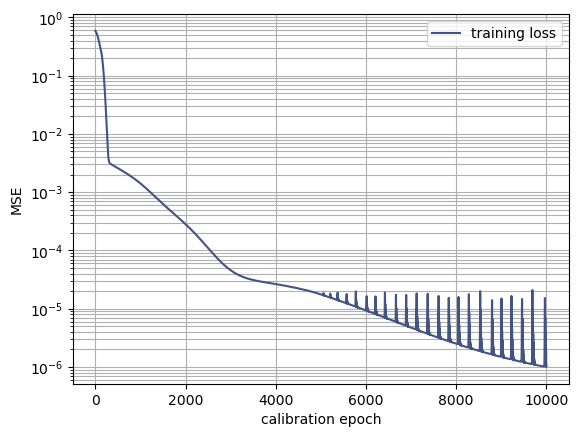

In [11]:
# Load and evaluate model
model_GSM = hc.main_GSM(constant)

t1 = now()
print(t1)

model_GSM.optimizer.learning_rate.assign(0.002)

h = model_GSM.fit([eps, dts], [sig], epochs = 10000,  verbose = 2)

t2 = now()
print('it took', t2 - t1, '(sec) to calibrate the model')


plt.figure(1, dpi=100)
plt.semilogy(h.history['loss'], label='training loss', color=(67/255, 83/255, 132/255))
plt.grid(which='both')
plt.xlabel('calibration epoch')
plt.ylabel('MSE')
plt.legend()

### Is the model able to predict seen data - Reproduce data?

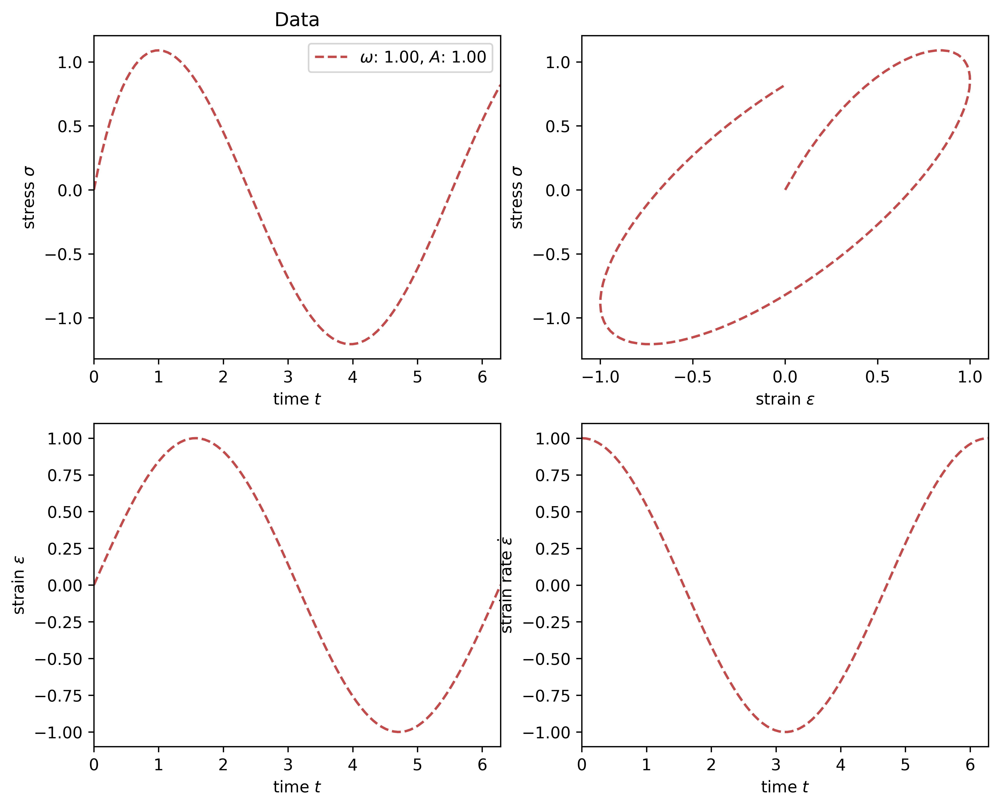

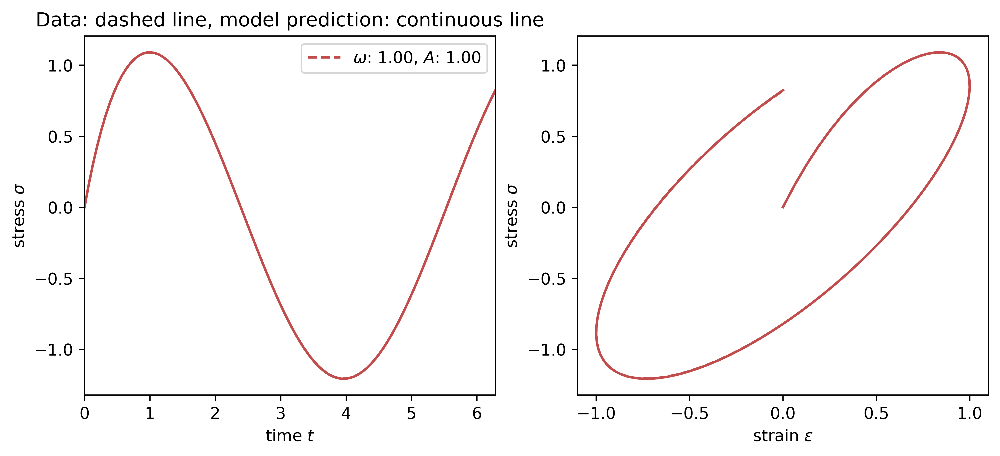

In [12]:
# Calibration data used for training 
E_infty = 0.5
E = 2
eta = 1

n = 100
omegas = [1]
As = [1]

eps, eps_dot, sig, dts = ld.generate_data_harmonic(E_infty, E, eta, n, omegas, As)
sig_GSM = model_GSM([eps, dts])
lp.plot_data(eps, eps_dot, sig, omegas, As)
lp.plot_model_pred(eps, sig, sig_GSM, omegas, As)

## Is the model able to predict unseen data (extrapolation)?
- Here I only change the amplitude and the frequency 

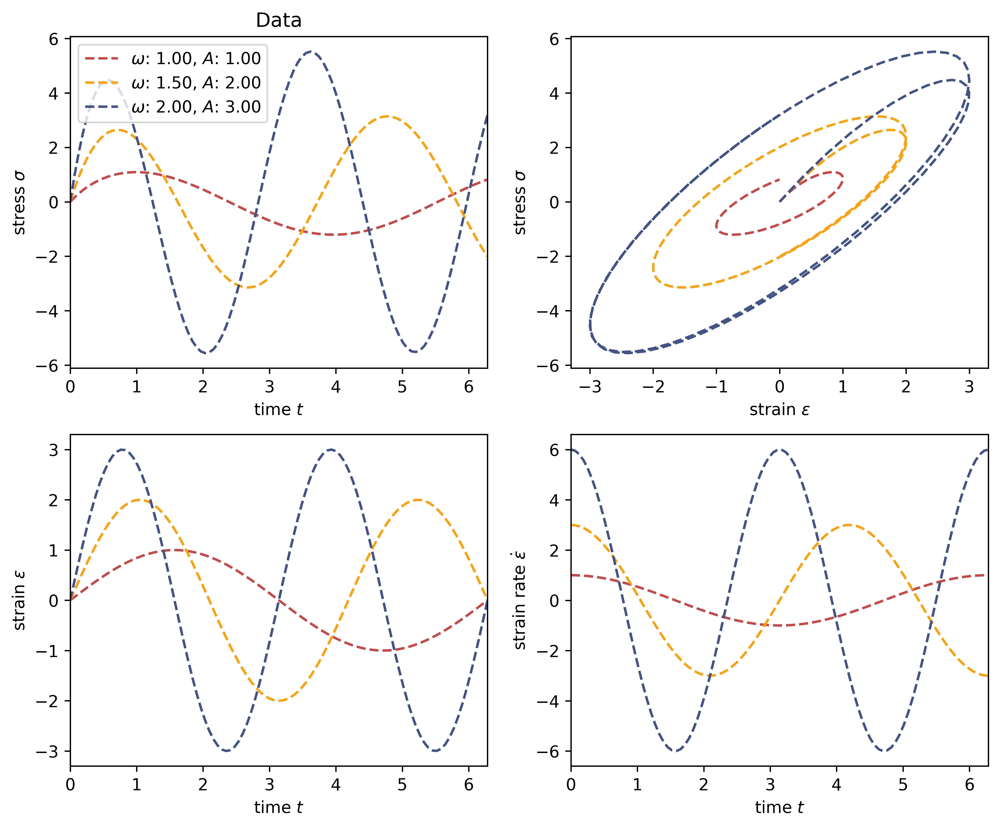

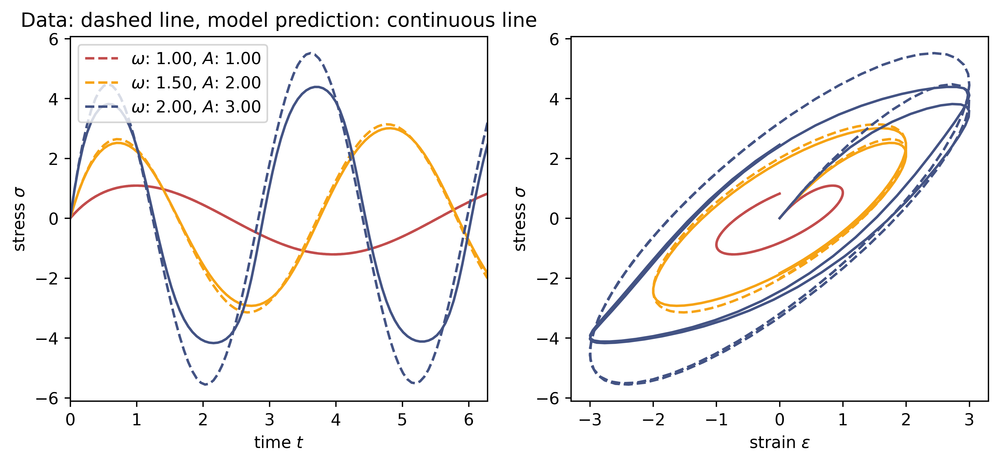

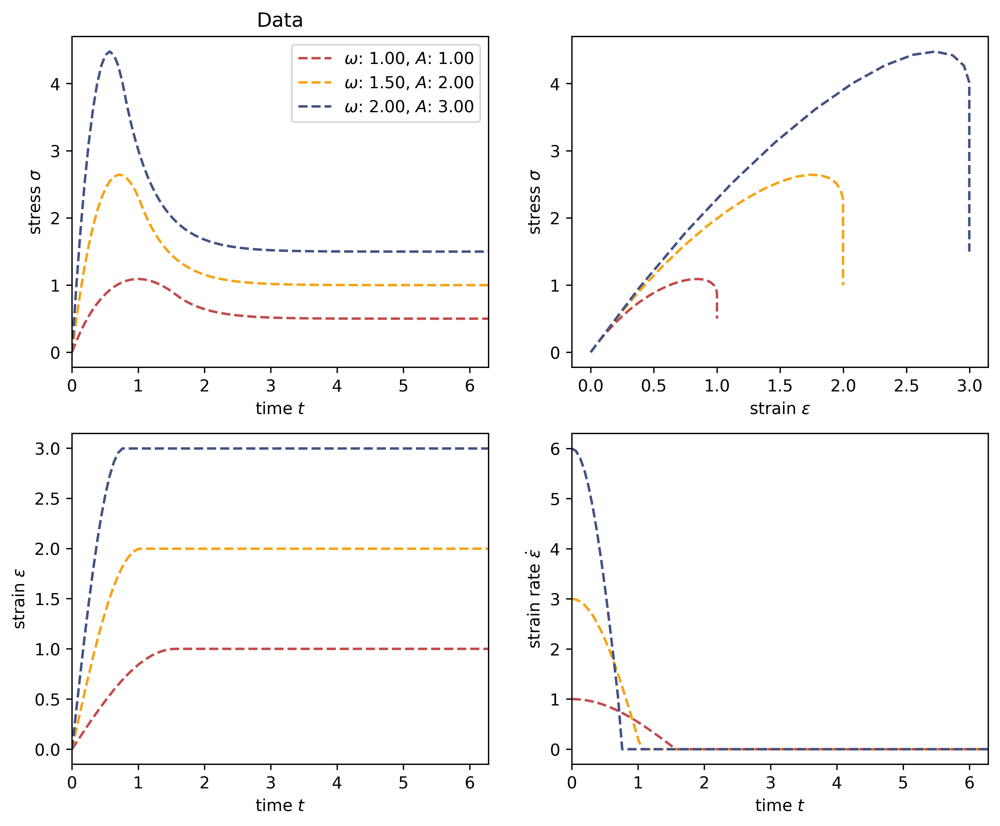

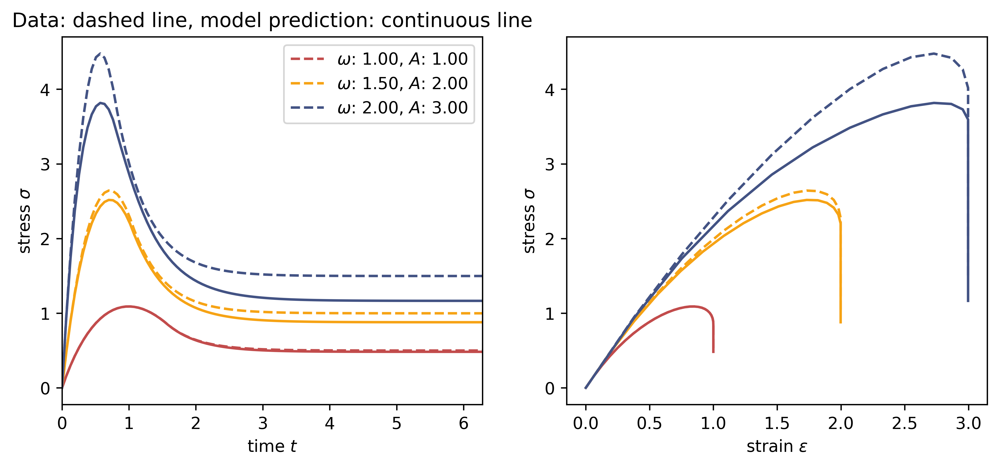

In [13]:
E_infty = 0.5
E = 2
eta = 1

n = 100

As = [1, 2, 3]
omegas = [1, 1.5, 2]

eps, eps_dot, sig, dts = ld.generate_data_harmonic(E_infty, E, eta, n, omegas, As)
sig_GSM = model_GSM([eps, dts])
lp.plot_data(eps, eps_dot, sig, omegas, As)
lp.plot_model_pred(eps, sig, sig_GSM, omegas, As)

eps, eps_dot, sig, dts = ld.generate_data_relaxation(E_infty, E, eta, n, omegas, As)
sig_GSM_relaxation = model_GSM([eps, dts])
lp.plot_data(eps, eps_dot, sig, omegas, As)
lp.plot_model_pred(eps, sig, sig_GSM_relaxation, omegas, As)

# GSM Model
#### Trained for large amplitudes and frequencies

In [15]:
E_inf = 0.5
E = 2
eta = 1
n = 100
omegas = [2]
As = [3]


constant = {'eta': 1} 

eps, eps_dot, sig, dts = ld.generate_data_harmonic(E_inf, E, eta, n, omegas, As)

2025-01-25 17:26:18.105343
Epoch 1/10000


/Users/harchaoum/anaconda3/lib/python3.10/site-packages/keras/src/layers/layer.py:391: UserWarning: `build()` was called on layer 'gsm_modell_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(


1/1 - 2s - 2s/step - loss: 13.7856
Epoch 2/10000
1/1 - 0s - 80ms/step - loss: 13.7652
Epoch 3/10000
1/1 - 0s - 68ms/step - loss: 13.7448
Epoch 4/10000
1/1 - 0s - 68ms/step - loss: 13.7245
Epoch 5/10000
1/1 - 0s - 62ms/step - loss: 13.7042
Epoch 6/10000
1/1 - 0s - 70ms/step - loss: 13.6839
Epoch 7/10000
1/1 - 0s - 62ms/step - loss: 13.6637
Epoch 8/10000
1/1 - 0s - 61ms/step - loss: 13.6435
Epoch 9/10000
1/1 - 0s - 58ms/step - loss: 13.6233
Epoch 10/10000
1/1 - 0s - 61ms/step - loss: 13.6031
Epoch 11/10000
1/1 - 0s - 59ms/step - loss: 13.5830
Epoch 12/10000
1/1 - 0s - 62ms/step - loss: 13.5629
Epoch 13/10000
1/1 - 0s - 62ms/step - loss: 13.5428
Epoch 14/10000
1/1 - 0s - 148ms/step - loss: 13.5227
Epoch 15/10000
1/1 - 0s - 66ms/step - loss: 13.5026
Epoch 16/10000
1/1 - 0s - 60ms/step - loss: 13.4825
Epoch 17/10000
1/1 - 0s - 58ms/step - loss: 13.4624
Epoch 18/10000
1/1 - 0s - 58ms/step - loss: 13.4423
Epoch 19/10000
1/1 - 0s - 59ms/step - loss: 13.4222
Epoch 20/10000
1/1 - 0s - 61ms/step 

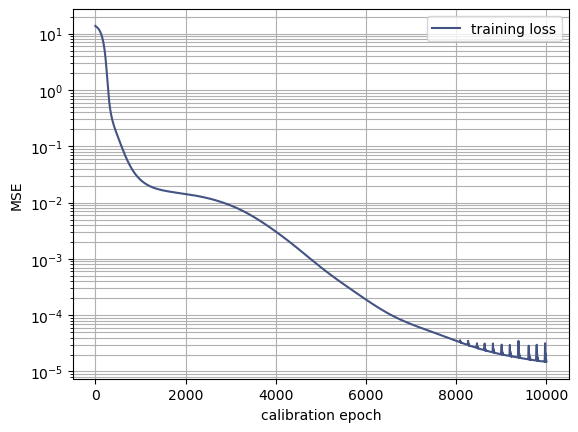

In [16]:
# Load and evaluate model
model_GSM = hc.main_GSM(constant)

t1 = now()
print(t1)

model_GSM.optimizer.learning_rate.assign(0.002)

h = model_GSM.fit([eps, dts], [sig], epochs = 10000,  verbose = 2)

t2 = now()
print('it took', t2 - t1, '(sec) to calibrate the model')


plt.figure(1, dpi=100)
plt.semilogy(h.history['loss'], label='training loss', color=(67/255, 83/255, 132/255))
plt.grid(which='both')
plt.xlabel('calibration epoch')
plt.ylabel('MSE')
plt.legend()

### Is the model able to predict seen data - Reproduce data?

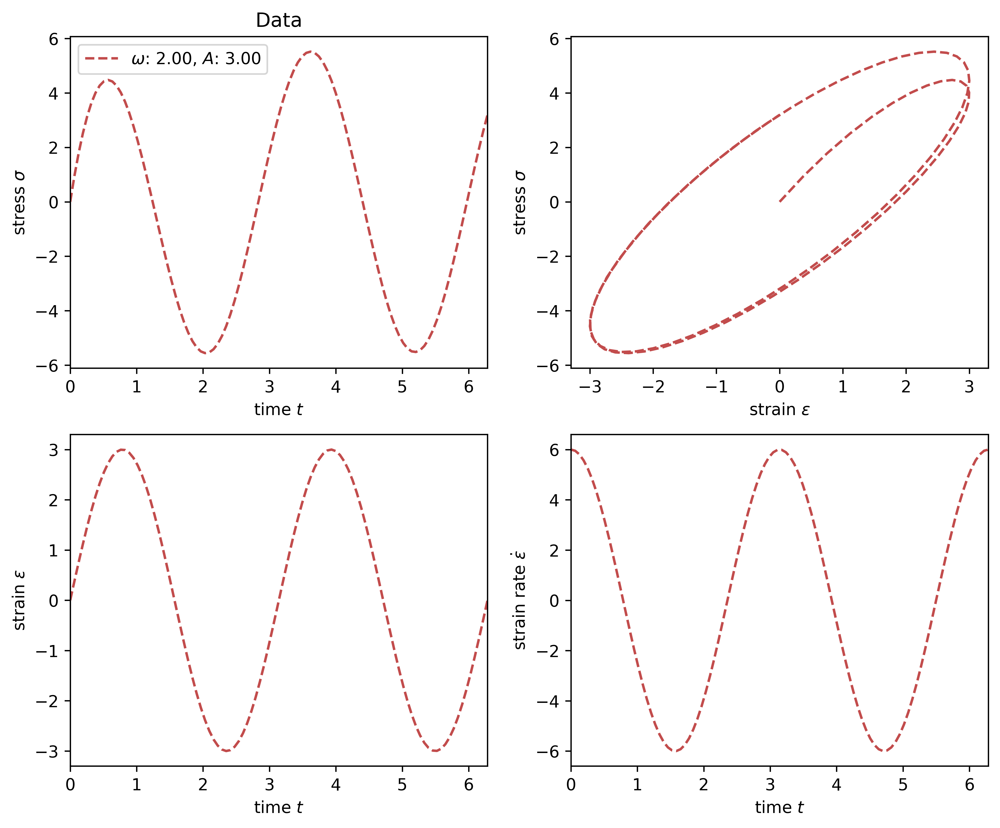

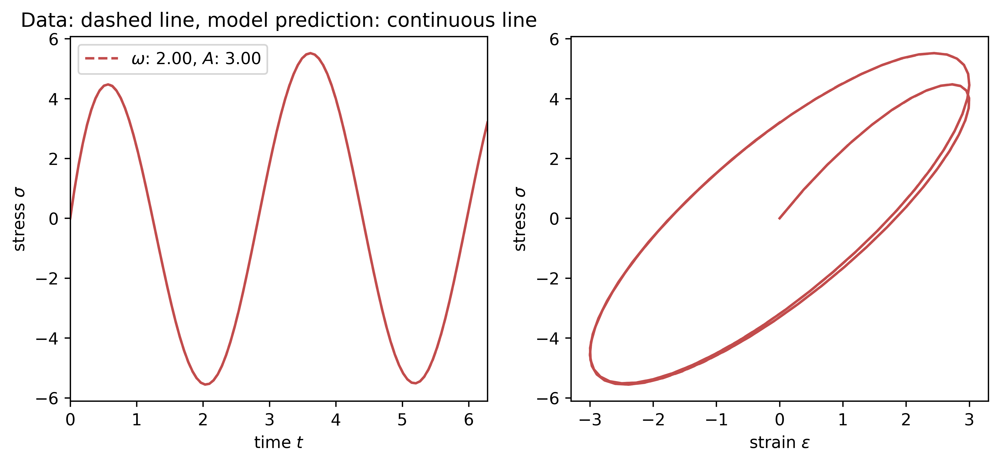

In [17]:
# Calibration data used for training 
E_infty = 0.5
E = 2
eta = 1

n = 100
omegas = [2]
As = [3]

eps, eps_dot, sig, dts = ld.generate_data_harmonic(E_infty, E, eta, n, omegas, As)
sig_GSM = model_GSM([eps, dts])
lp.plot_data(eps, eps_dot, sig, omegas, As)
lp.plot_model_pred(eps, sig, sig_GSM, omegas, As)

## Is the model able to predict unseen data (extrapolation)?
- Here I only change the amplitude and the frequency 


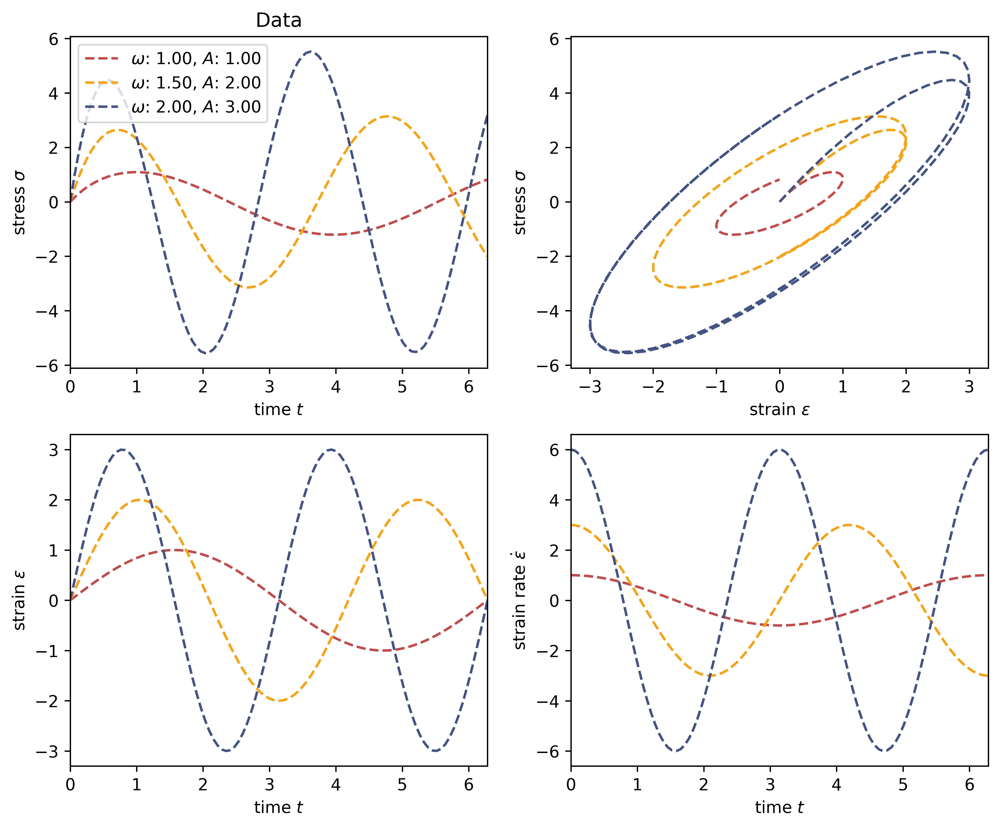

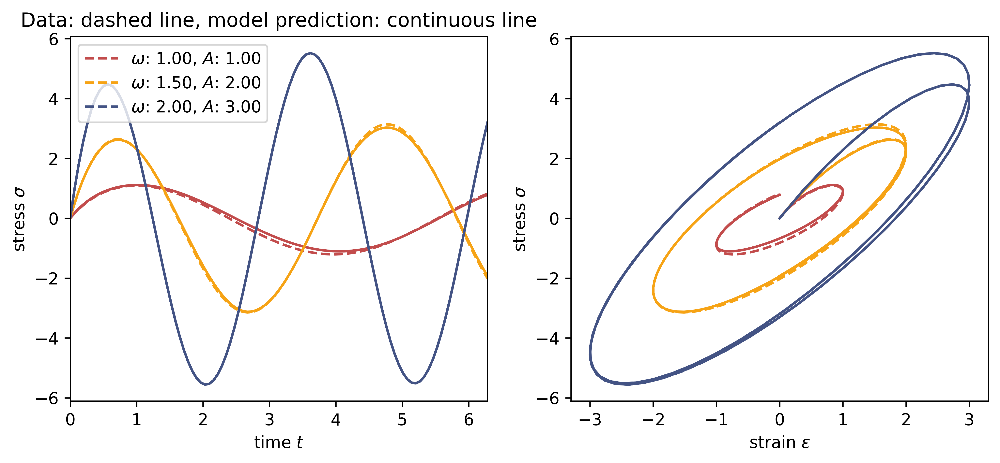

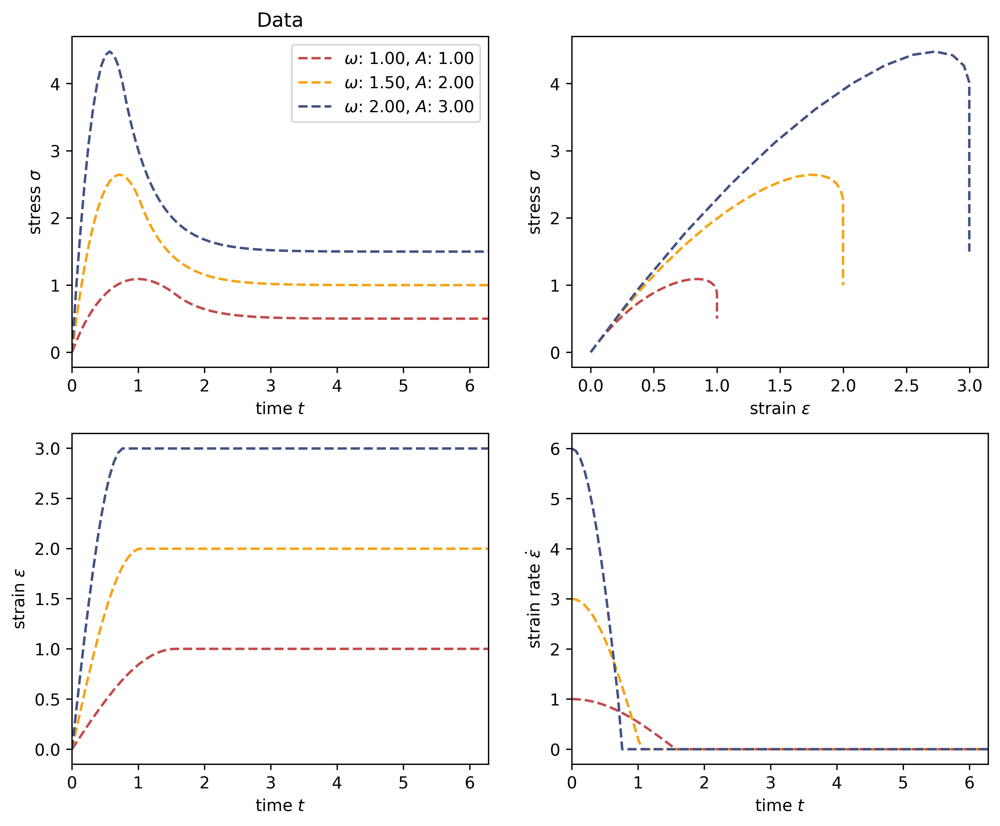

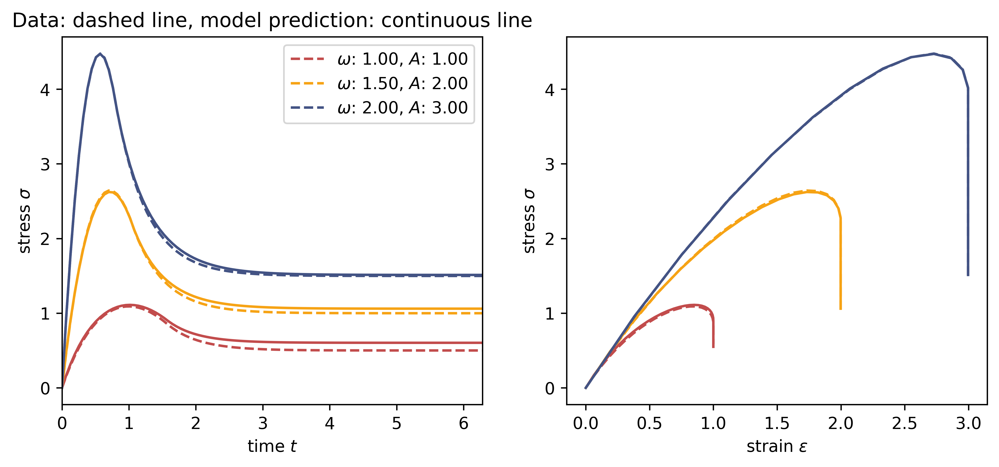

In [19]:
E_infty = 0.5
E = 2
eta = 1

n = 100

As = [1, 2, 3]
omegas = [1, 1.5, 2]

eps, eps_dot, sig, dts = ld.generate_data_harmonic(E_infty, E, eta, n, omegas, As)
sig_GSM = model_GSM([eps, dts])
lp.plot_data(eps, eps_dot, sig, omegas, As)
lp.plot_model_pred(eps, sig, sig_GSM, omegas, As)

eps, eps_dot, sig, dts = ld.generate_data_relaxation(E_infty, E, eta, n, omegas, As)
sig_GSM_relaxation = model_GSM([eps, dts])
lp.plot_data(eps, eps_dot, sig, omegas, As)
lp.plot_model_pred(eps, sig, sig_GSM_relaxation, omegas, As)

#### What will happen if I change the time step?
Not much, as the NN learns the relationship of the energy with the elongation (eps) and the elongation of the dampe

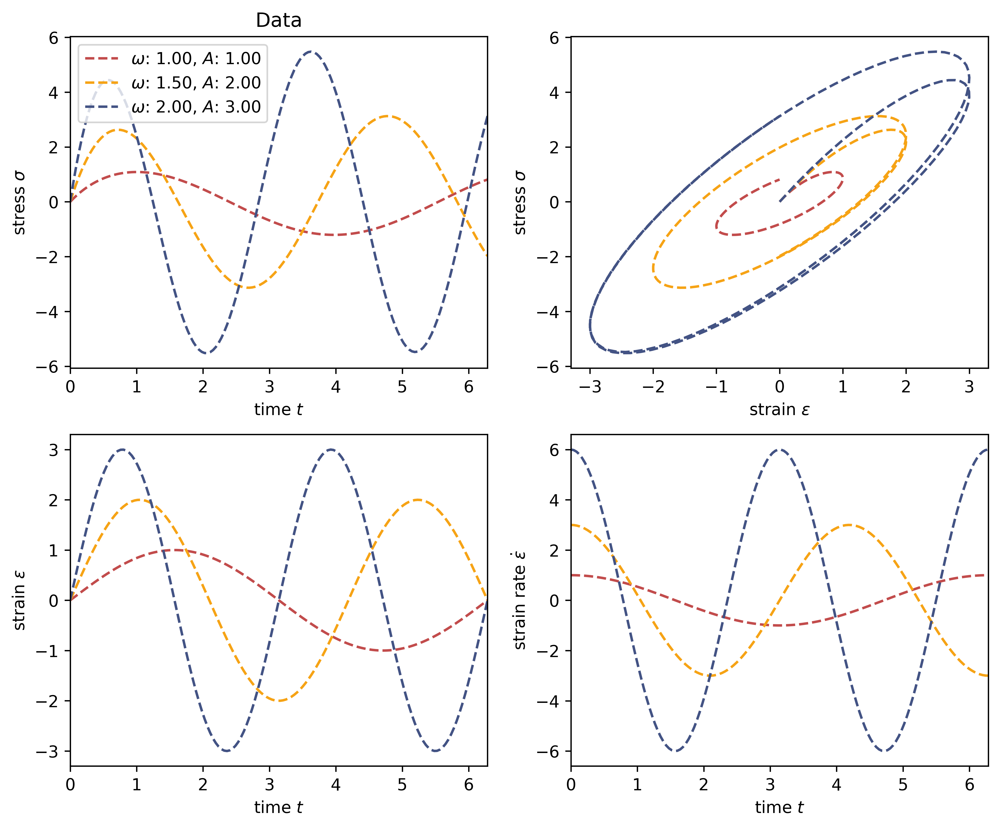

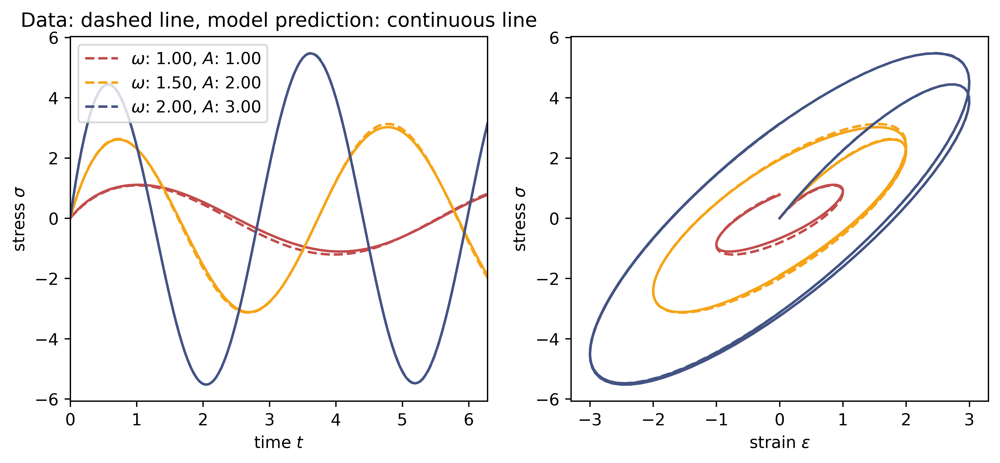

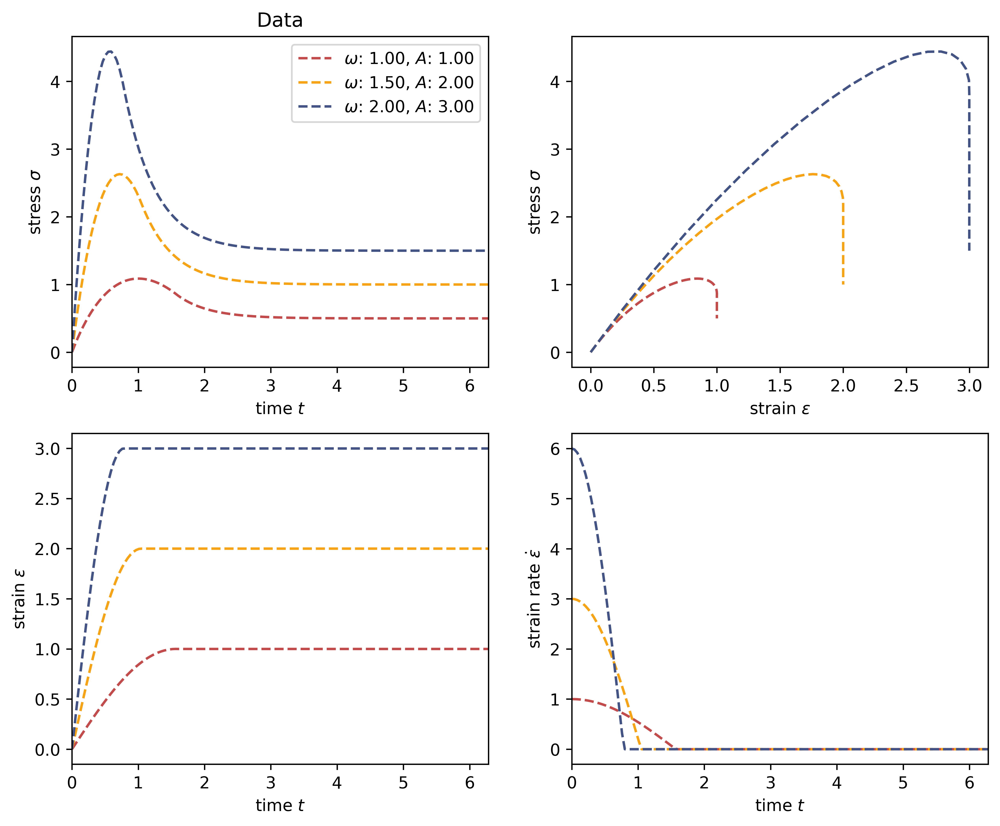

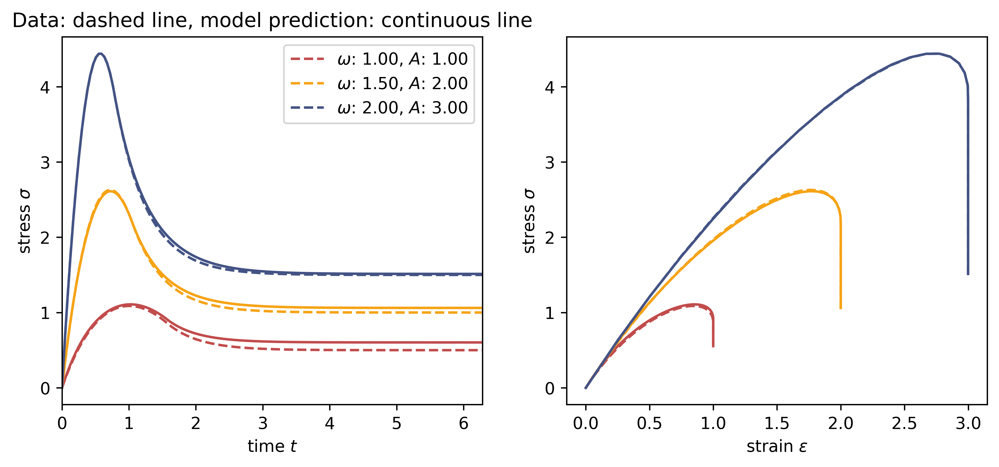

In [68]:
E_infty = 0.5
E = 2
eta = 1

n = 150

As = [1, 2, 3]
omegas = [1, 1.5, 2]

eps, eps_dot, sig, dts = ld.generate_data_harmonic(E_infty, E, eta, n, omegas, As)
sig_GSM = model_GSM([eps, dts])
lp.plot_data(eps, eps_dot, sig, omegas, As)
lp.plot_model_pred(eps, sig, sig_GSM, omegas, As)

eps, eps_dot, sig, dts = ld.generate_data_relaxation(E_infty, E, eta, n, omegas, As)
sig_GSM_relaxation = model_GSM([eps, dts])
lp.plot_data(eps, eps_dot, sig, omegas, As)
lp.plot_model_pred(eps, sig, sig_GSM_relaxation, omegas, As)